In [1]:
import pandas as pd
import numpy as np
import mne
from matplotlib import pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

#import pyqt5
%matplotlib qt

ImportError: Failed to import any of the following Qt binding modules: PyQt6, PySide6, PyQt5, PySide2

In [2]:
raw = mne.io.read_raw_egi('sourcedata/test_hdmi_1_20230303_111019.mff')

Reading EGI MFF Header from /home/james/q1k/q1k_eeget_init/sourcedata/test_hdmi_1_20230303_111019.mff...
    Reading events ...
    Assembling measurement info ...
    Synthesizing trigger channel "STI 014" ...
    Excluding events {dstr} ...


In [3]:
raw.plot()

Using qt as 2D backend.


<mne_qt_browser._pg_figure.MNEQtBrowser(0x5001980) at 0x7ff7bcedec40>

In [4]:
events = mne.find_events(raw, stim_channel='STI 014')

85 events found
Event IDs: [1 2 3 4 5 6 7 8 9]


In [5]:
events

array([[22865,     0,     2],
       [22897,     0,     8],
       [24477,     0,     1],
       [24917,     0,     9],
       [25081,     0,     8],
       [25251,     0,     9],
       [25413,     0,     8],
       [25583,     0,     9],
       [25747,     0,     8],
       [26498,     0,     3],
       [26529,     0,     8],
       [28110,     0,     1],
       [28266,     0,     9],
       [28413,     0,     8],
       [28567,     0,     9],
       [28746,     0,     8],
       [28900,     0,     9],
       [29064,     0,     8],
       [30131,     0,     3],
       [30163,     0,     8],
       [31744,     0,     1],
       [31899,     0,     9],
       [32046,     0,     8],
       [32216,     0,     9],
       [32363,     0,     8],
       [32534,     0,     9],
       [32695,     0,     8],
       [33765,     0,     4],
       [33796,     0,     8],
       [35380,     0,     1],
       [35533,     0,     9],
       [35680,     0,     8],
       [35833,     0,     9],
       [36

In [27]:
et = mne.io.read_raw_eyelink ('sourcedata/scott_vep.asc')

Loading sourcedata/scott_vep.asc
Pixel coordinate data detected.
Pass `scalings=dict(eyegaze=1e3)` when using plot method to make traces more legible.
Pupil-size area reported.
There are 6 recording blocks in this file. Times between blocks will be annotated with bad_rec_gap.


In [28]:
dir(et)

['__class__',
 '__contains__',
 '__del__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__enter__',
 '__eq__',
 '__exit__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__len__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__setitem__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_annotations',
 '_cals',
 '_check_bad_segment',
 '_comp',
 '_create_dataframes',
 '_create_info',
 '_cropped_samp',
 '_data',
 '_dtype',
 '_dtype_',
 '_event_lines',
 '_filenames',
 '_first_samps',
 '_first_time',
 '_gap_desc',
 '_get_buffer_size',
 '_get_channel_positions',
 '_get_recording_datetime',
 '_getitem',
 '_handle_tmin_tmax',
 '_href_to_radian',
 '_infer_col_names',
 '_init_kwargs',
 '_last_samps',
 '_last_time',
 '_make_eyelink_annots',
 '_make_gap_annots',
 '_meas_date',
 '_orig_units',
 '_parse_get_set_params

In [29]:
df_et = et.to_data_frame()

In [30]:
df_et

,time,xpos_right,ypos_right,pupil_right,DIN
0,0.000,966.2,559.8,889.0,0.0
1,0.001,966.3,559.7,886.0,0.0
2,0.002,966.4,559.4,884.0,0.0
3,0.003,966.4,559.4,882.0,0.0
4,0.004,966.3,558.6,881.0,0.0
...,...,...,...,...,...
412068,412.068,985.8,597.3,647.0,0.0
412069,412.069,985.8,597.4,647.0,0.0
412070,412.070,985.9,597.5,647.0,0.0
412071,412.071,986.0,597.7,647.0,0.0


In [31]:
fig = px.scatter(df_et,
                x='time',
                y='DIN',
                opacity=.5,
                marginal_y="histogram",
                marginal_x="histogram",
                hover_data={
                        'time',
                        'DIN'})
fig.show()


In [32]:
input_deriv = np.diff(df_et['DIN'])
deriv_indices = np.where(input_deriv > 1)[0]
deriv_indices_deriv = np.diff(deriv_indices)

In [33]:
fig = px.scatter(
                y=deriv_indices_deriv,
                #y='DIN',
                opacity=.5,
                marginal_y="histogram",
                marginal_x="histogram")
fig.show()


In [34]:
fig = px.line(y=deriv_indices_deriv)
fig.show()


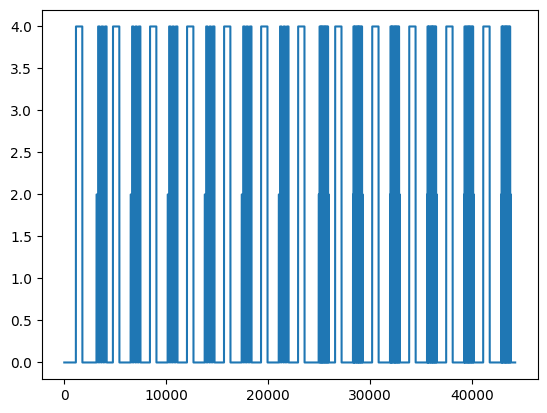

In [10]:
plt.plot(df_et['DIN'])